<h1> COVID-19 Global Data Tracker </h1>

<h3>Project Description</h3>

This project provides a comprehensive analysis of global <b>COVID-19 trends</b> using real-world data. By analyzing key metrics—such as confirmed cases, deaths, recoveries, and vaccinations—across different countries and time periods, we aim to uncover patterns and insights into the pandemic's global impact. The analysis involves data cleaning, exploratory data analysis (EDA), comparative metrics, and rich visualizations to communicate meaningful findings.

<h3>📌 Table of Contents</h3>
<ol>
    <li>Introduction</li>
    <li>Data Collection</li>
    <li>Data Cleaning & Preprocessing</li>
    <li> Exploratory Data Analysis (EDA)</li>
    <li>Country & Regional Comparisons</li>
    <li>Vaccination Analysis</li>
    <li>Data Visualization (Charts & Maps)</li>
    <li>Insights & Conclusions</li>
    <li> References</li>
</ol>

<h2 id="intro">Introduction</h2>


COVID-19, caused by the SARS-CoV-2 virus, has led to a global health crisis since early 2020. Tracking its trends across regions is essential for public health decisions, policy planning, and understanding the global response. This project aims to analyze the progression of the pandemic across countries using publicly available datasets.

<h3>Project objectives</h3>
<h5>Project Objectives: </h5>

✅ Import and clean COVID-19 global data <br>
✅ Analyze time trends (cases, deaths, vaccinations) <br>
✅ Compare metrics across countries/regions <br>
✅ Visualize trends with charts and maps <br>

<h2>Data Collection</h2>

The data will be imported from the link provided.


In [321]:
# importing necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [322]:
#importing the dataset
covid_df = pd.read_csv("https://covid.ourworldindata.org/data/owid-covid-data.csv")

# Preview
covid_df.head()


,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-01-05,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-01-06,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-01-07,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-01-08,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-01-09,0.0,0.0,NaN,0.0,0.0,NaN,...,NaN,37.746,0.5,64.83,0.511,41128772,NaN,NaN,NaN,NaN


<h3>Data cleaning and preprocessing</h3>

<h5> cleaning steps:</h5>
<ul>
    <li>Handle missing values</li>
    <li>Filter relevant columns</li>
    <li>Convert date types></li>
</ul>
    

   

    

In [325]:
#checking for data structure
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 429435 entries, 0 to 429434
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    429435 non-null  object 
 1   continent                                   402910 non-null  object 
 2   location                                    429435 non-null  object 
 3   date                                        429435 non-null  object 
 4   total_cases                                 411804 non-null  float64
 5   new_cases                                   410159 non-null  float64
 6   new_cases_smoothed                          408929 non-null  float64
 7   total_deaths                                411804 non-null  float64
 8   new_deaths                                  410608 non-null  float64
 9   new_deaths_smoothed                         409378 non-null  float64
 

In [326]:
#Selecting relevant columns
selected_columns = [
    'iso_code', 'continent', 'location', 'date',
    'total_cases', 'new_cases', 'total_deaths', 'new_deaths',
    'total_cases_per_million', 'total_deaths_per_million',
    'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated',
    'new_vaccinations', 'total_vaccinations_per_hundred',
    'population'
]


In [327]:
#filtering out the data based on selected column
cv_data = covid_df[selected_columns]
cv_data.head()

,iso_code,continent,location,date,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,total_deaths_per_million,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,population
0,AFG,Asia,Afghanistan,2020-01-05,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,41128772
1,AFG,Asia,Afghanistan,2020-01-06,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,41128772
2,AFG,Asia,Afghanistan,2020-01-07,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,41128772
3,AFG,Asia,Afghanistan,2020-01-08,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,41128772
4,AFG,Asia,Afghanistan,2020-01-09,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,41128772


In [328]:
#ensuring date column is in date format
cv_data.loc[:,'date'] = pd.to_datetime(cv_data['date'])

# Filter only countries using iso_code: country codes have 3 letters; aggregate rows like 'OWID_WRL' have prefixes like 'OWID'
cv_data = cv_data[~cv_data['iso_code'].str.startswith('OWID')]

In [329]:
#checking for missing values
cv_data.isnull().sum()

iso_code                               0
continent                              0
location                               0
date                                   0
total_cases                         5269
new_cases                           6914
total_deaths                        5269
new_deaths                          6465
total_cases_per_million             5269
total_deaths_per_million            5269
total_vaccinations                328776
people_vaccinated                 332768
people_fully_vaccinated           335858
new_vaccinations                  343018
total_vaccinations_per_hundred    328776
population                             0
dtype: int64

In [330]:
#computing the percentage of missing values for each columns
missing_data = cv_data.isnull().sum().reset_index()
missing_data.columns = ['Column', 'Missing Values']
missing_data['% Missing'] = (missing_data['Missing Values'] / len(cv_data)) * 100
missing_data = missing_data.sort_values(by='Missing Values', ascending=False)
missing_data

,Column,Missing Values,% Missing
13,new_vaccinations,343018,86.771681
12,people_fully_vaccinated,335858,84.960449
11,people_vaccinated,332768,84.178786
10,total_vaccinations,328776,83.168948
14,total_vaccinations_per_hundred,328776,83.168948
5,new_cases,6914,1.749003
7,new_deaths,6465,1.635421
4,total_cases,5269,1.332875
6,total_deaths,5269,1.332875
8,total_cases_per_million,5269,1.332875


In [331]:
#replacing missing values in new cases and new deaths with 0
cv_data[['new_cases', 'new_deaths']] = cv_data[['new_cases', 'new_deaths']].fillna(0)

In [332]:
#droping rows with missing values in  'total_cases', 'total_deaths', 'total_cases_per_million' and 'total_deaths_per_million'
cv_data = cv_data.dropna(subset=[
    'total_cases', 'total_deaths',
    'total_cases_per_million', 'total_deaths_per_million'
])


In [333]:
#Extracting vaccination related data
vaccination_df = cv_data.dropna(subset=[
    'total_vaccinations', 'people_vaccinated',
    'people_fully_vaccinated', 'new_vaccinations'
])


In [334]:
vaccination_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 42814 entries, 508 to 428763
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   iso_code                        42814 non-null  object 
 1   continent                       42814 non-null  object 
 2   location                        42814 non-null  object 
 3   date                            42814 non-null  object 
 4   total_cases                     42814 non-null  float64
 5   new_cases                       42814 non-null  float64
 6   total_deaths                    42814 non-null  float64
 7   new_deaths                      42814 non-null  float64
 8   total_cases_per_million         42814 non-null  float64
 9   total_deaths_per_million        42814 non-null  float64
 10  total_vaccinations              42814 non-null  float64
 11  people_vaccinated               42814 non-null  float64
 12  people_fully_vaccinated         42

<h1>Exploratory Data Analysis</h1>
<h3>📊 EDA: Exploring COVID-19 Trends</h3>
Now, we will carry out exploratory data analysis on our cleaned data.

In [336]:
# Set style
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (12, 6)

<h4>Total COVID-19 Cases over time</h4>

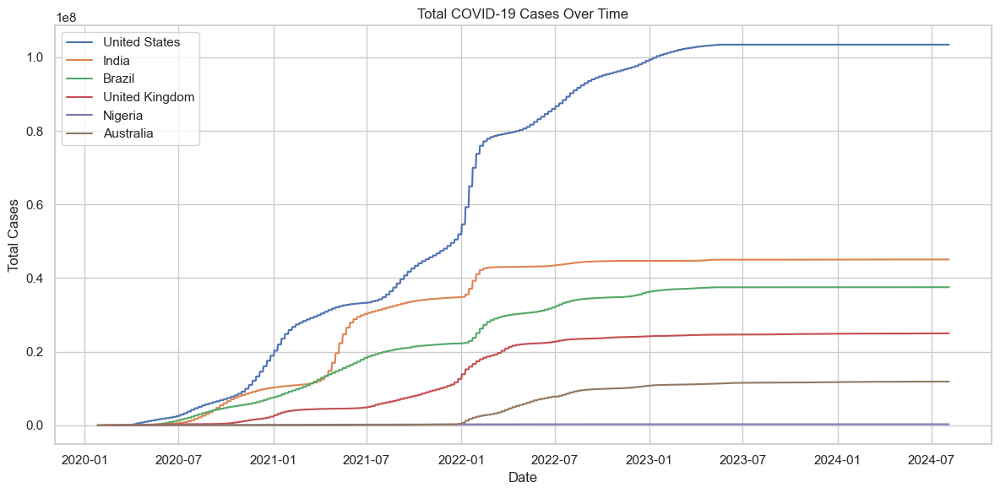

In [371]:
# Define countries of interest
countries = ['United States', 'India', 'Brazil', 'United Kingdom', 'Nigeria', 'Australia']

# Filter data
df_countries = cv_data[cv_data['location'].isin(countries)]

# Plot
plt.figure()
for country in countries:
    country_data = df_countries[df_countries['location'] == country]
    plt.plot(country_data['date'], country_data['total_cases'], label=country)

plt.title('Total COVID-19 Cases Over Time')
plt.xlabel('Date')
plt.ylabel('Total Cases')
plt.legend()
plt.tight_layout()
plt.show()


<h4>Total COVID-19 Deaths over time</h4>

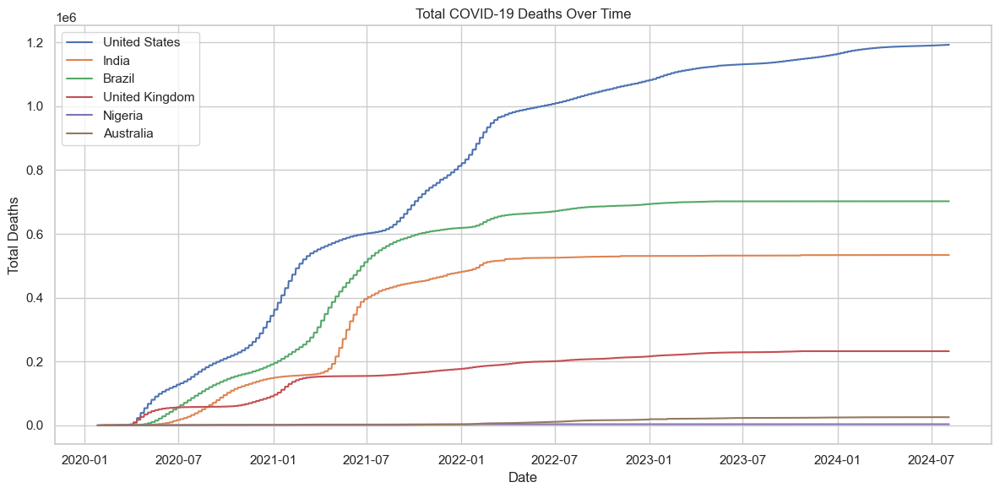

In [373]:
plt.figure()
for country in countries:
    country_data = df_countries[df_countries['location'] == country]
    plt.plot(country_data['date'], country_data['total_deaths'], label=country)

plt.title('Total COVID-19 Deaths Over Time')
plt.xlabel('Date')
plt.ylabel('Total Deaths')
plt.legend()
plt.tight_layout()
plt.show()


<h4>Daily New Cases Between Countries</h4>

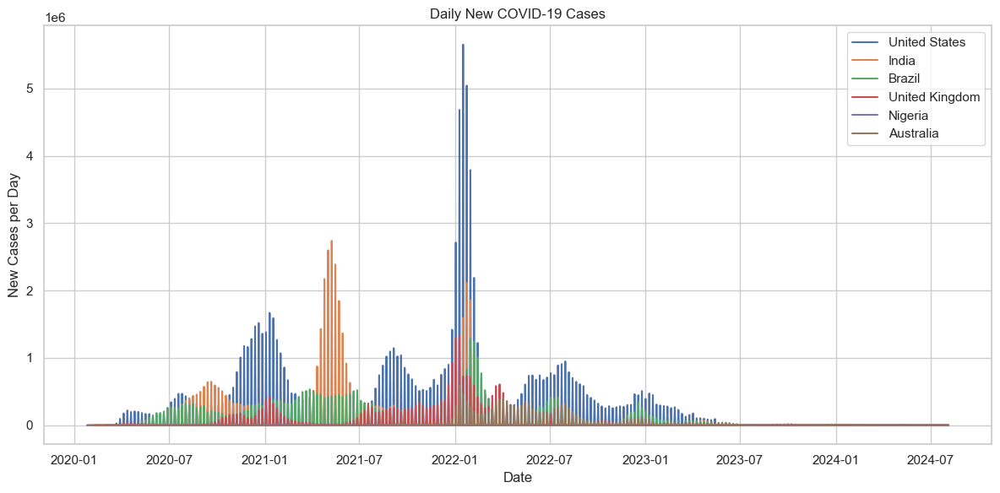

In [375]:
plt.figure()
for country in countries:
    country_data = df_countries[df_countries['location'] == country]
    plt.plot(country_data['date'], country_data['new_cases'], label=country)

plt.title('Daily New COVID-19 Cases')
plt.xlabel('Date')
plt.ylabel('New Cases per Day')
plt.legend()
plt.tight_layout()
plt.show()


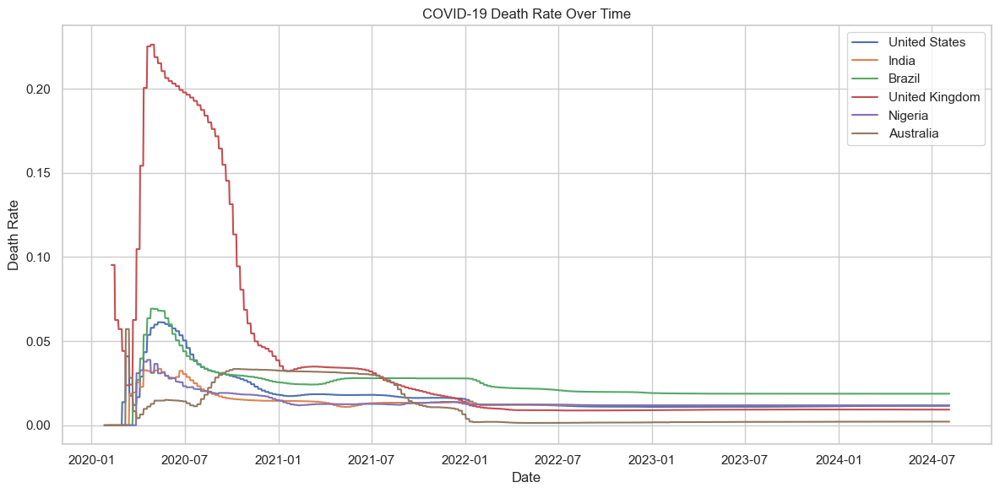

In [377]:
#filtering out rows where total deaths is greater than total cases

cv_data = cv_data[cv_data['total_cases'] > cv_data['total_deaths']]

# Create new column
cv_data['death_rate'] = cv_data['total_deaths'] / cv_data['total_cases']

# Filter extreme values (where total_cases is 0 or NaN)
cv_data['death_rate'] = cv_data['death_rate'].replace([float('inf'), -float('inf')], None)

# Filter countries
df_countries = cv_data[cv_data['location'].isin(countries)]

# Plot
plt.figure()
for country in countries:
    country_data = df_countries[df_countries['location'] == country]
    plt.plot(country_data['date'], country_data['death_rate'], label=country)

plt.title('COVID-19 Death Rate Over Time')
plt.xlabel('Date')
plt.ylabel('Death Rate')
plt.legend()
plt.tight_layout()
plt.show()


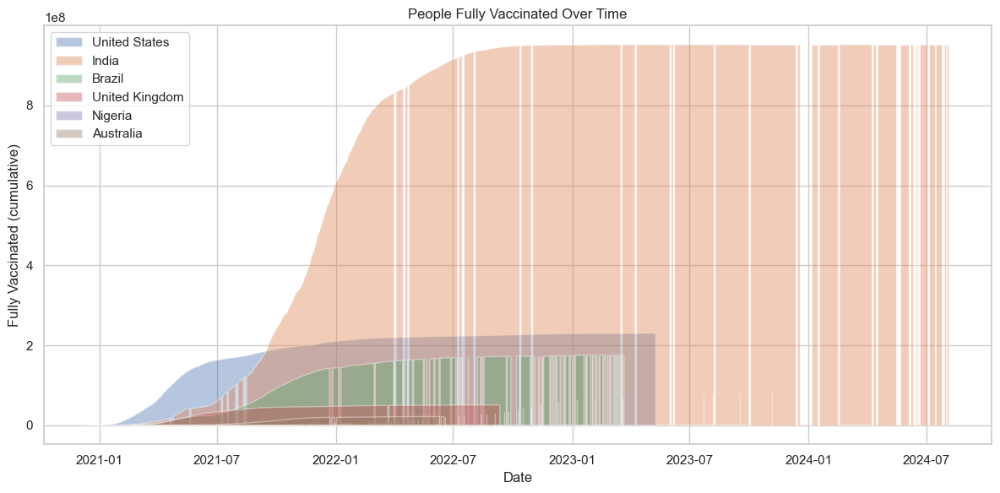

In [391]:
plt.figure()
for country in countries:
    country_data = cv_data[cv_data['location'] == country]
    plt.fill_between(
        country_data['date'], country_data['people_fully_vaccinated'],
        alpha=0.4, label=country
    )

plt.title('People Fully Vaccinated Over Time')
plt.xlabel('Date')
plt.ylabel('Fully Vaccinated (cumulative)')
plt.legend()
plt.tight_layout()
plt.show()


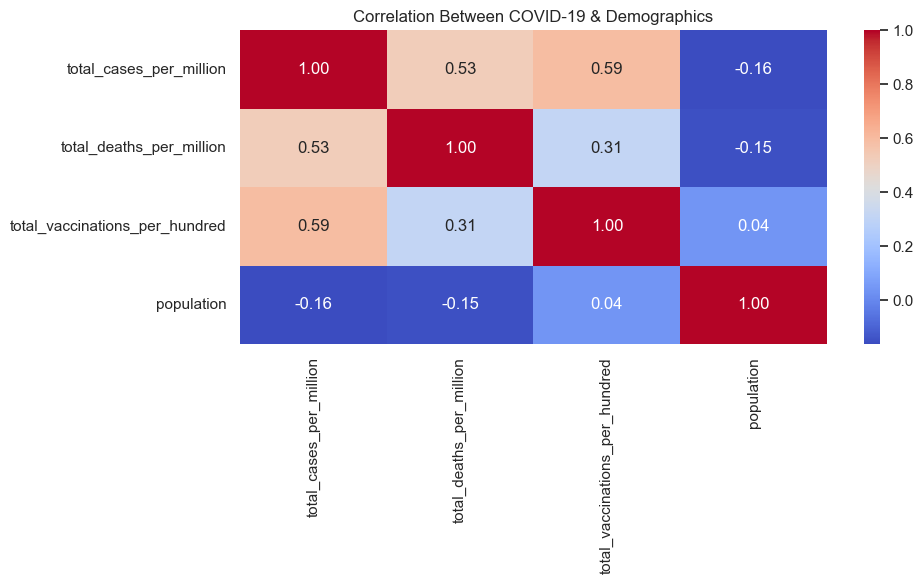

In [396]:
# Select relevant numeric columns
corr_columns = [
    'total_cases_per_million', 'total_deaths_per_million',
    'total_vaccinations_per_hundred', 'population'
]

# Drop rows with NaN
corr_df = cv_data[corr_columns].dropna()

# Plot correlation heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(corr_df.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Between COVID-19 & Demographics')
plt.tight_layout()
plt.show()


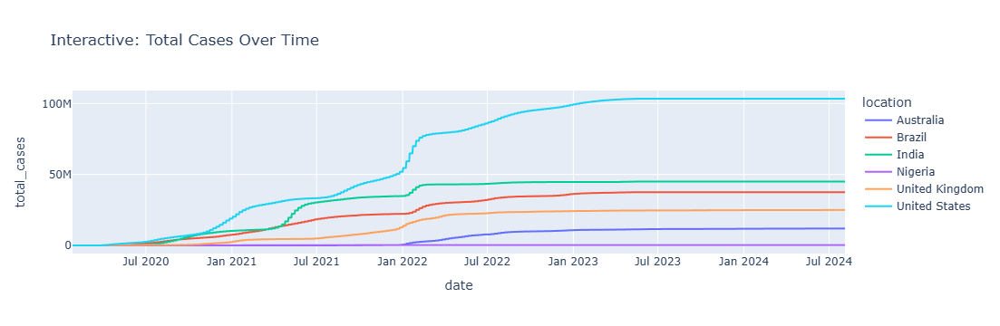

In [398]:
import plotly.express as px

fig = px.line(
    cv_data[cv_data['location'].isin(countries)],
    x='date', y='total_cases', color='location',
    title='Interactive: Total Cases Over Time'
)
fig.show()


C:\Users\Hadew\AppData\Local\Temp\ipykernel_44056\3231366350.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




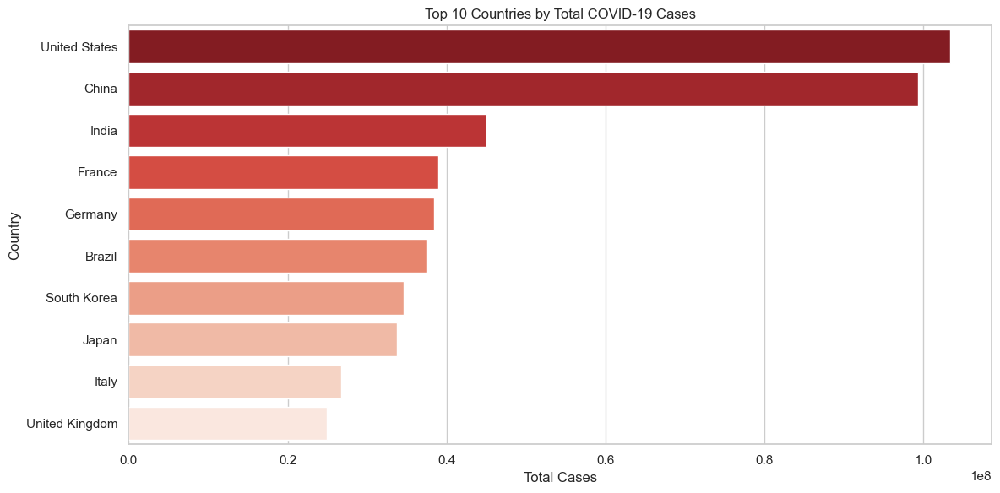

In [400]:
# Get the latest data for each country
latest_df = cv_data.sort_values('date').drop_duplicates('location', keep='last')

# Top 10 countries by total cases
top10 = latest_df.nlargest(10, 'total_cases')

plt.figure(figsize=(12, 6))
sns.barplot(data=top10, x='total_cases', y='location', palette='Reds_r')
plt.title('Top 10 Countries by Total COVID-19 Cases')
plt.xlabel('Total Cases')
plt.ylabel('Country')
plt.tight_layout()
plt.show()


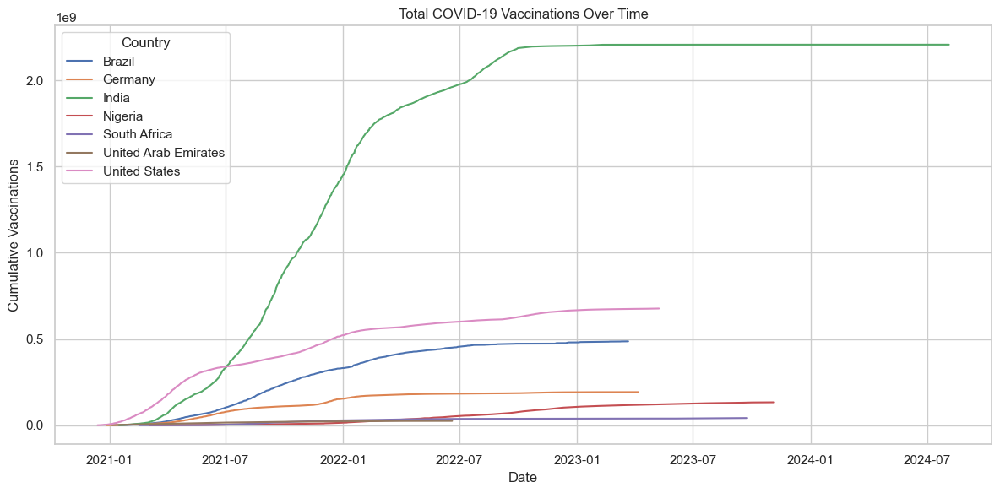

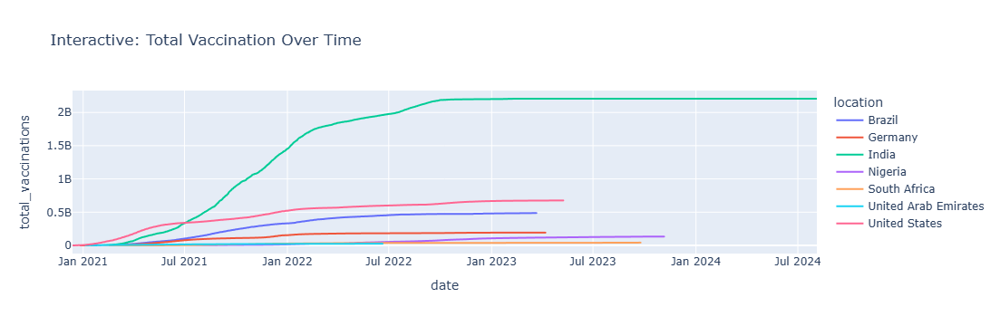

In [408]:
# Filter for selected countries and non-null values
vacc_countries = ['United States', 'India', 'Brazil', 'Germany', 'South Africa', 'Nigeria', 'United Arab Emirates']
vax_df = cv_data[cv_data['location'].isin(vacc_countries) & cv_data['total_vaccinations'].notnull()]

# Plot line chart
plt.figure(figsize=(12, 6))
sns.lineplot(data=vax_df, x='date', y='total_vaccinations', hue='location')
plt.title('Total COVID-19 Vaccinations Over Time')
plt.xlabel('Date')
plt.ylabel('Cumulative Vaccinations')
plt.legend(title='Country')
plt.tight_layout()
plt.show()


fig2 = px.line(
   vax_df,
    x='date', y='total_vaccinations', color='location',
    title='Interactive: Total Vaccination Over Time'
)
fig2.show()

C:\Users\Hadew\AppData\Local\Temp\ipykernel_44056\3365152546.py:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




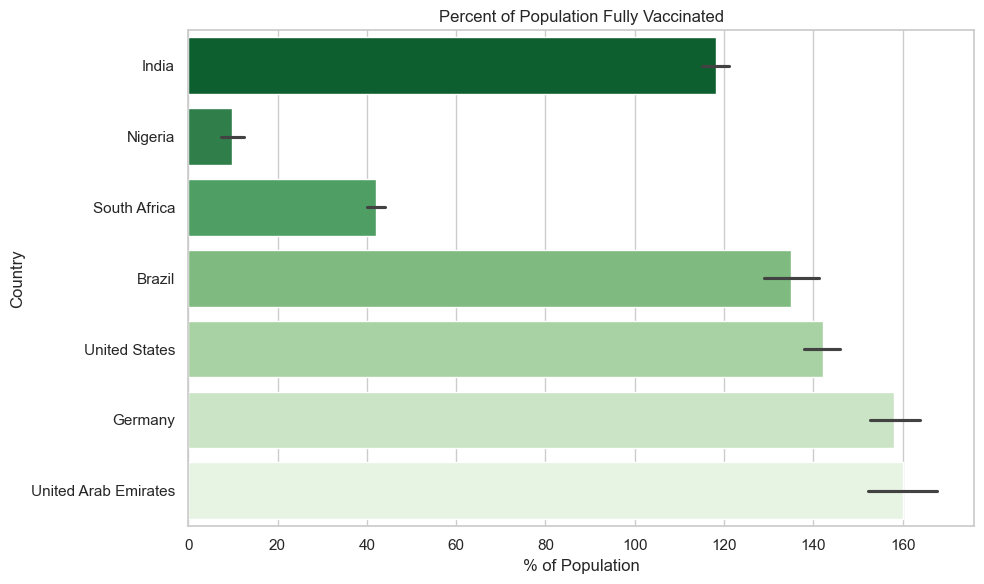

In [442]:
# Latest records for each country
latest_vax = cv_data.sort_values('total_vaccinations_per_hundred')
latest_vax = latest_vax[latest_vax['location'].isin(vacc_countries)]

# Plot
plt.figure(figsize=(10, 6))
sns.barplot(data=latest_vax, x='total_vaccinations_per_hundred', y='location', palette='Greens_r')
plt.title('Percent of Population Fully Vaccinated')
plt.xlabel('% of Population')
plt.ylabel('Country')
plt.tight_layout()
plt.show()


In [450]:

# Get latest data per country
latest_map_data = cv_data.sort_values('date').drop_duplicates('location', keep='last')

# Drop rows without iso_code (required for map)
map_df = latest_map_data[['iso_code', 'location', 'total_cases_per_million', 
                          'total_vaccinations']].dropna()


In [467]:
fig = px.choropleth(
    cv_data,
    locations='iso_code',
    color='total_cases_per_million',
    hover_name='location',
    color_continuous_scale='Reds',
    title='Total COVID-19 Cases per Million People (by Country)',
    labels={'total_cases_per_million': 'Cases per Million'},
    projection='natural earth'
)

fig.update_layout(geo=dict(showframe=False, showcoastlines=True))
fig.show()
